# Lab02-Image Processing and Analysis

In [1]:
import numpy as np
import pandas as pd
import cv2
from matplotlib import pyplot as plt
from pylab import imread
from skimage.color import rgb2gray

### Bài 1

#### Hàm show ảnh

In [3]:
def imshows(ImageData, LabelData, rows, cols, gridType = False):
    #Convert ImageData and LabelData to List
    from matplotlib import pyplot as plt
    ImageArray = list(ImageData)
    LabelArray = list(LabelData)
    if(rows == 1 & cols == 1):
        fig = plt.figure(figsize=(20, 20))
    else:
        fig = plt.figure(figsize=(cols*8, rows*5))
        
    for i in range(1, cols * rows + 1):
        fig.add_subplot(rows, cols, i)
        image = ImageArray[i - 1]
        #Nếu như kênh màu < 3 -> hiển thị ảnh grayscale
        #Ngược lại, hiển thị ảnh màu
        if (len(image.shape) < 3):
            plt.imshow(image, plt.cm.gray)
            plt.grid(gridType)
        else:
            plt.imshow(image)
            plt.grid(gridType)
        plt.title(LabelArray[i - 1])
    plt.show()
    
def ShowThreeImages(IM1, IM2, IM3):
    imshows([IM1, IM2, IM3], ["Image 1","Image 2", "Image 3"], 1, 3)
def ShowTwoImages(IM1, IM2):
    imshows([IM1, IM2], ["Image 1","Image 2"], 1, 2)
def ShowOneImage(IM):
    imshows([IM], ["Image"], 1, 1)
def ShowListImages(listImage, row, col):
    listCaption = []
    for i in range(len(listImage)):
        listCaption.append(str(i))
    imshows(listImage,listCaption,row,col)
            

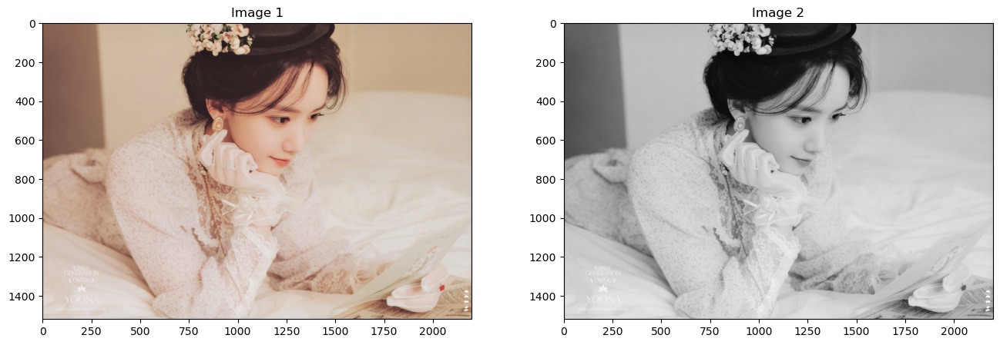

In [6]:
#Đọc ảnh
image_color = imread("yoongie.jpg")

#Chuyển sang ảnh xám
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

#Hiển thị ảnh
ShowTwoImages(image_color, image_gray)

#### Viết function cho biết thông tin của bức ảnh

In [7]:
def info(img):
    Image = img
    Width = Image.shape[1]
    Height = Image.shape[0]
    Channel = len(Image.shape)
    print("Width: ", Width, "Height: ", Height, "Channel: ", Channel)

    if(Channel == 2):
        print("Min Intensity: ", Image.min(), "Max Intensity: ", Image.max())
    else:
        print("Red - Min Intensity: ", Image[:,:,0].min(), "Max Intensity: ", Image[:,:,0].max())
        print("Green - Min Intensity: ", Image[:,:,1].min(), "Max Intensity: ", Image[:,:,1].max())
        print("Blue - Min Intensity: ", Image[:,:,2].min(), "Max Intensity: ", Image[:,:,2].max())  

#Hiển thị thông tin của ảnh màu
img1 = image_color.copy()
info(img1)
print("-----------------------------------------------")
#Hiển thị thông tin của ảnh xám
img2 = image_gray.copy()
info(img2)

Width:  2200 Height:  1520 Channel:  3
Red - Min Intensity:  30 Max Intensity:  255
Green - Min Intensity:  19 Max Intensity:  247
Blue - Min Intensity:  11 Max Intensity:  247
-----------------------------------------------
Width:  2200 Height:  1520 Channel:  2
Min Intensity:  23 Max Intensity:  246


#### Hiển thị 24 bức ảnh theo bit của từng kênh màu R, G, B

In [8]:
#Hàm chuyển đổi từ kiểu số nguyên (int) sang bit
def intToBitArray(img):
    row, col = img.shape
    list = []
    for i in range(row):
        for j in range(col):
            list.append(np.binary_repr(img[i][j], width = 8))
            #width = 8: chuỗi có độ dài là 8
    return list
    #Hàm binary_repr() trả về giá trị bit dạng chuỗi, không phải số nguyên

def bitplane(bitImgVal, img1D):
    bitList = [int( i[bitImgVal]) for i in img1D]
    return bitList
def getBitImage(index, img2D):
    imageIn1D = intToBitArray(img2D) 
    #chuyển img2D thành danh sách chuỗi bit 1D
    imageBit = np.array(bitplane(index, imageIn1D))
    imageBit = np.reshape(imageBit, img2D.shape)
    return imageBit
def getAllBitImage(img2D):
    img2D_Bit = list()
    for i in range(8):
        img2D_Bit.append(getBitImage(i, img2D))
    return img2D_Bit

##### Kênh màu R

List have 8 images


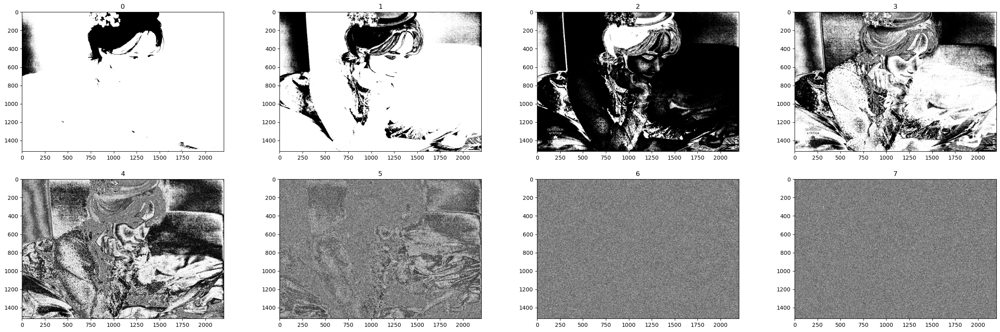

In [10]:
Channel_R = getAllBitImage(image_color[:,:,0])
print("List have", len(Channel_R), "images")
ShowListImages(Channel_R, 2, 4)

##### Kênh màu G

List have 8 images


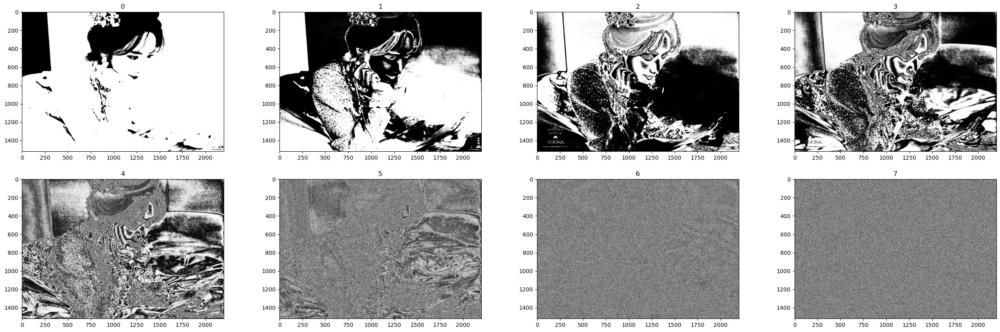

In [16]:
Channel_G = getAllBitImage(image_color[:,:,1])
print("List have", len(Channel_G), "images")
ShowListImages(Channel_G, 2, 4)

##### Kênh màu B

List have 8 images


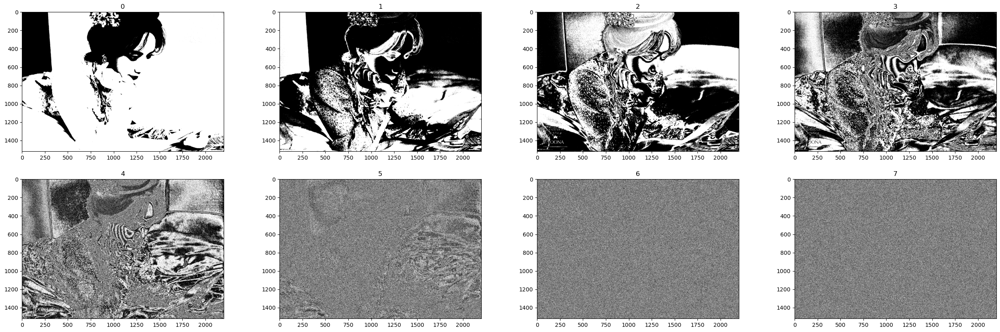

In [17]:
Channel_B = getAllBitImage(image_color[:,:,2])
print("List have", len(Channel_B), "images")
ShowListImages(Channel_B, 2, 4)

#### Hiển thị 24 bức ảnh theo bit của từng kênh màu H, S, V

##### Kênh màu H

List have 8 images


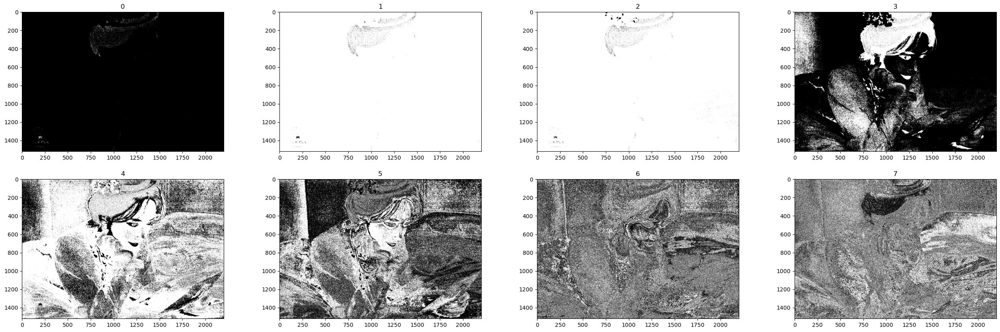

In [13]:
#Chuyển ảnh từ RGB sang HSV:
img_hsv = cv2.cvtColor(image_color, cv2.COLOR_BGR2HSV)

Channel_H = getAllBitImage(img_hsv[:,:,0])
print("List have", len(Channel_H), "images")
ShowListImages(Channel_H, 2, 4)

##### Kênh màu S

List have 8 images


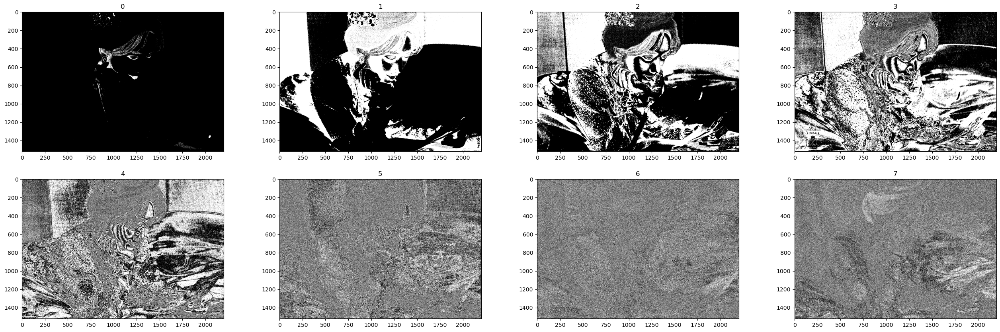

In [14]:
Channel_S = getAllBitImage(img_hsv[:,:,1])
print("List have", len(Channel_S), "images")
ShowListImages(Channel_S, 2, 4)

##### Kênh màu V

List have 8 images


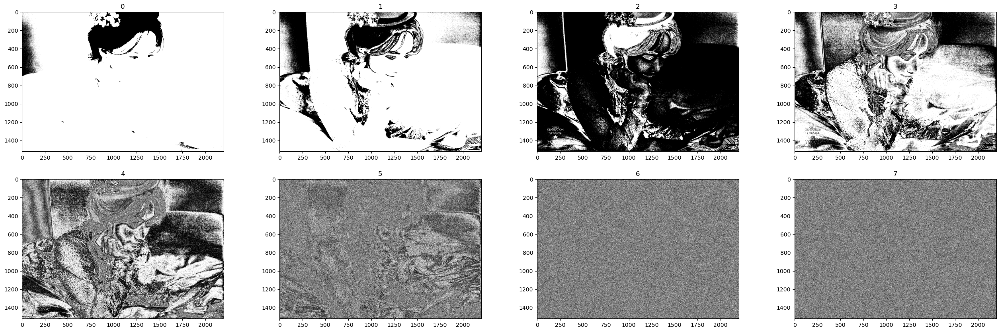

In [15]:
Channel_V = getAllBitImage(img_hsv[:,:,2])
print("List have", len(Channel_V), "images")
ShowListImages(Channel_V, 2, 4)

#### Cho biết trong 24 ảnh bit theo kênh R, G, B có ảnh nào có thể dùng để trích xuất đối tượng hay không. Nếu có thì hiển thị ảnh bit đó ra

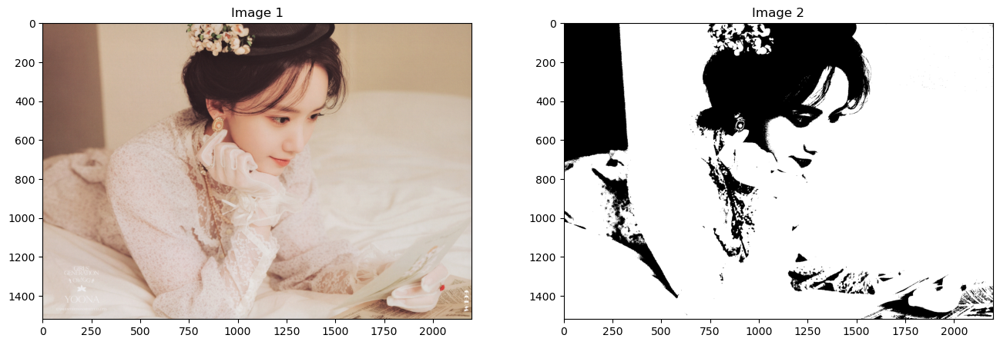

In [18]:
CellMask01 = Channel_B[0]
ShowTwoImages(image_color, CellMask01)

#### Cho biết trong 24 ảnh bit theo kênh H, S, V có ảnh nào có thể dùng để trích xuất đối tượng hay không. Nếu có thì hiển thị ảnh bit đó ra

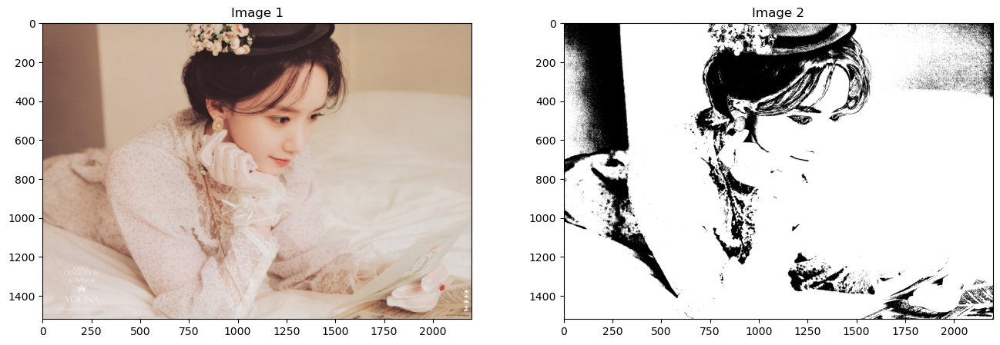

In [19]:
CellMask02 = Channel_V[1]
ShowTwoImages(image_color, CellMask02)

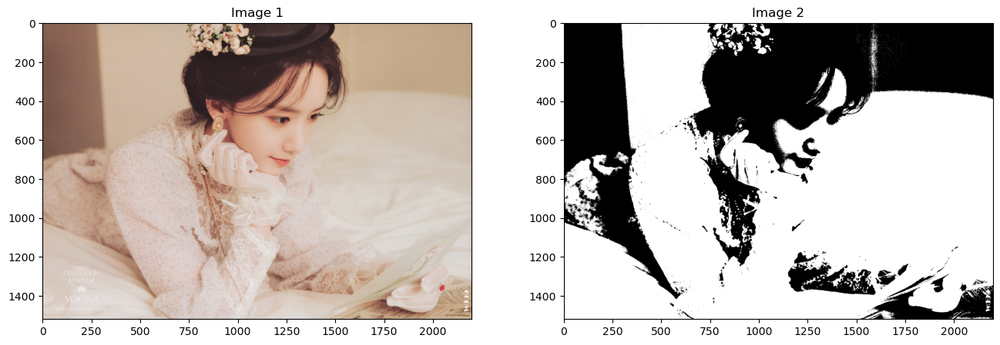

In [20]:
# Get color by range color in RGB from [0,0,150] to [255,255,255]
lower = np.array([0,0,150])
upper = np.array([255,255,255])
CellMask03 = cv2.inRange(image_color, lower, upper)
ShowTwoImages(image_color, CellMask03)

In [21]:
def SegmentColorImageByMask(IM, Mask):    
    Mask = Mask.astype(np.uint8)
    result = cv2.bitwise_and(IM, IM, mask = Mask)
    return result

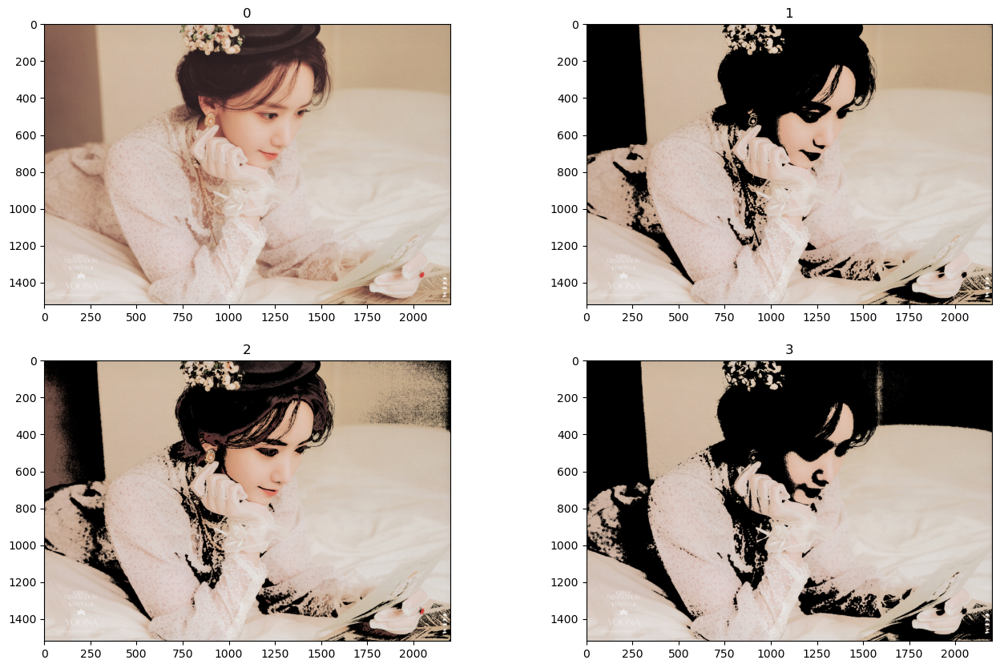

In [23]:
CellMask01_rgb = SegmentColorImageByMask(image_color, CellMask01)
CellMask02_rgb = SegmentColorImageByMask(image_color, CellMask02)
CellMask03_rgb = SegmentColorImageByMask(image_color, CellMask03)
ShowListImages([image_color, CellMask01_rgb, CellMask02_rgb, CellMask03_rgb], 2, 2)

### Bài 2

####  Function input ảnh màu, xuất ảnh chân dung xám và chân dùng màu của ảnh đó 


Image Size: (1106, 1633, 3)


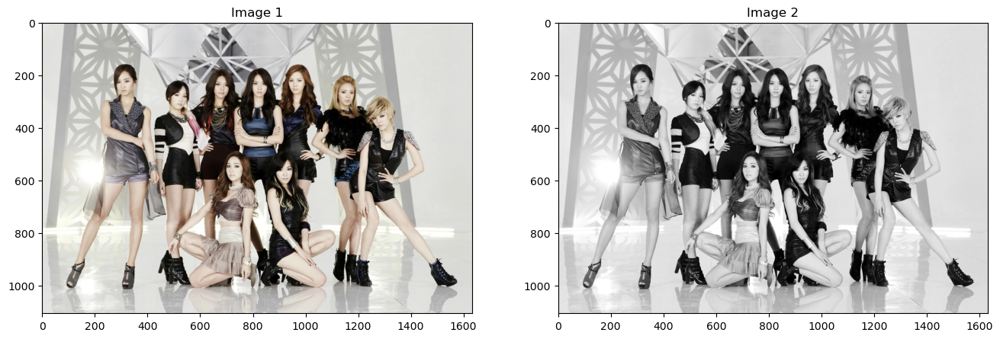

In [25]:
#Read Image
image_color = imread("theboys.jpg")

#Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

#Display Image
print("Image Size:", image_color.shape)
ShowTwoImages(image_color, image_gray)

Rescaled Size 0.5:  (553, 816)


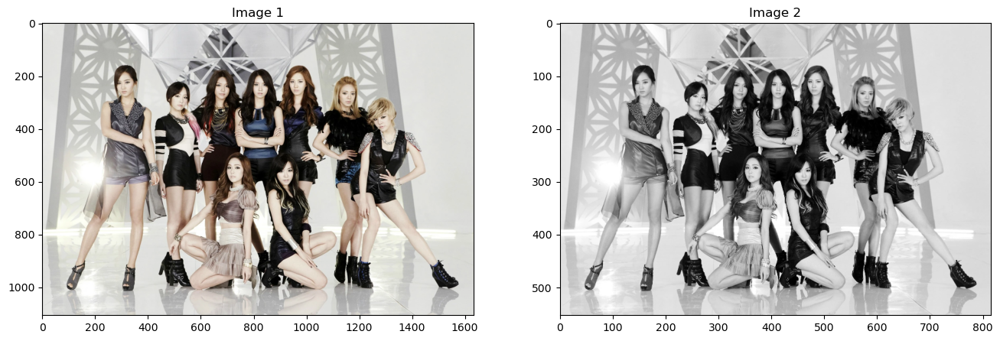

In [26]:
from skimage.transform import rescale, resize
def colorToGray(image):
    img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    img_rescaled_05 = rescale(img, 0.5, anti_aliasing = False)
    print("Rescaled Size 0.5: ", img_rescaled_05.shape)
    ShowTwoImages(image, img_rescaled_05)

colorToGray(image_color)

#### Tìm chọn range màu lower và upper để trích xuất được các khuôn mặt trong ảnh màu 


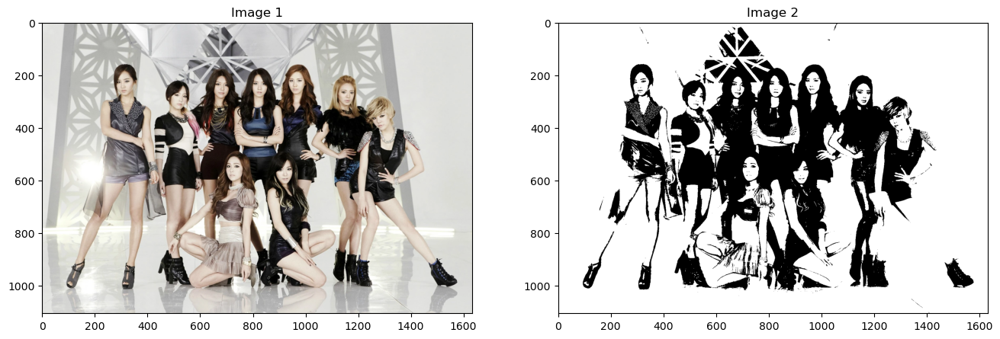

In [27]:
lower = np.array([0,0,150])
upper = np.array([255,255,255])
CellMask04 = cv2.inRange(image_color, lower, upper)
ShowTwoImages(image_color, CellMask04)

### Bài 3

Image Size: (1067, 1600, 3)


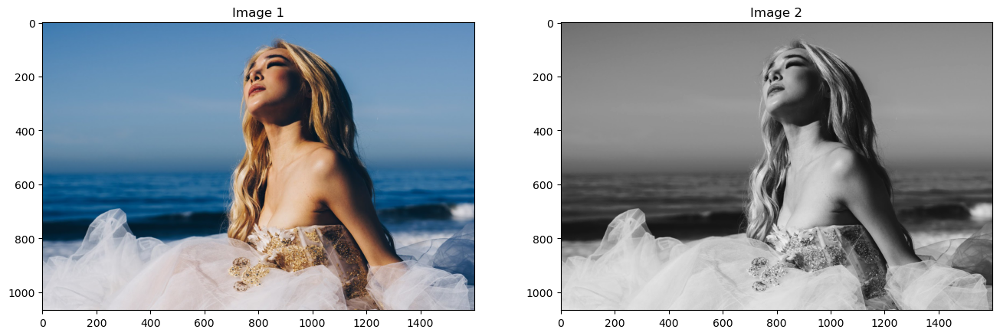

In [4]:
# Read Image 
image_color = imread("ppany.jpg")
# Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image
print("Image Size:", image_color.shape)
ShowTwoImages(image_color, image_gray)

#### Xuất ảnh xoay các góc 30,45,60 độ

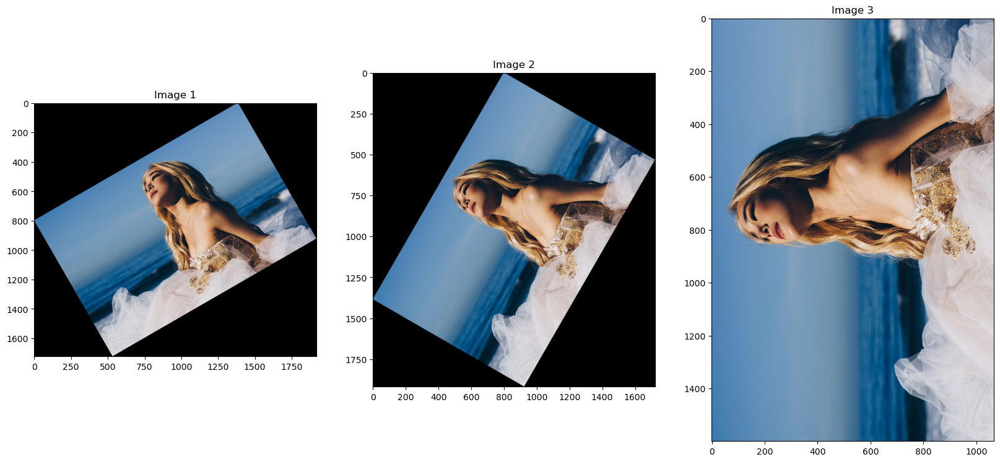

In [29]:
from skimage.transform import rotate
image_rotate_30 = rotate(image_color, 30, resize = True)
image_rotate_60 = rotate(image_color, 60, resize = True)
image_rotate_90 = rotate(image_color, 90, resize = True)
ShowThreeImages(image_rotate_30, image_rotate_60, image_rotate_90)

#### Xuất ảnh đối xứng qua trục hoành và trục tung đi qua tâm ảnh


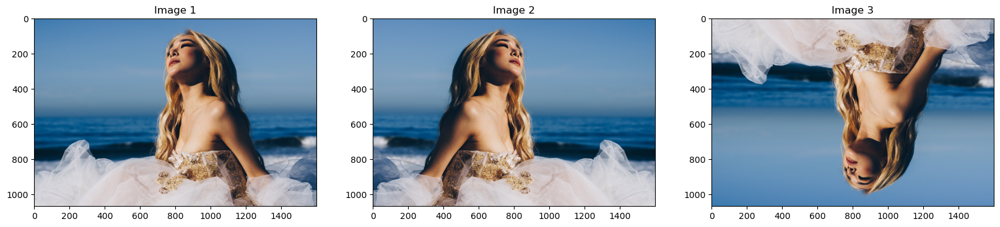

In [30]:
horizontal_flip = image_color[:, ::-1]
vertical_flip = image_color[::-1, :]

ShowThreeImages(image_color, horizontal_flip, vertical_flip)

#### Xuất ảnh inversion


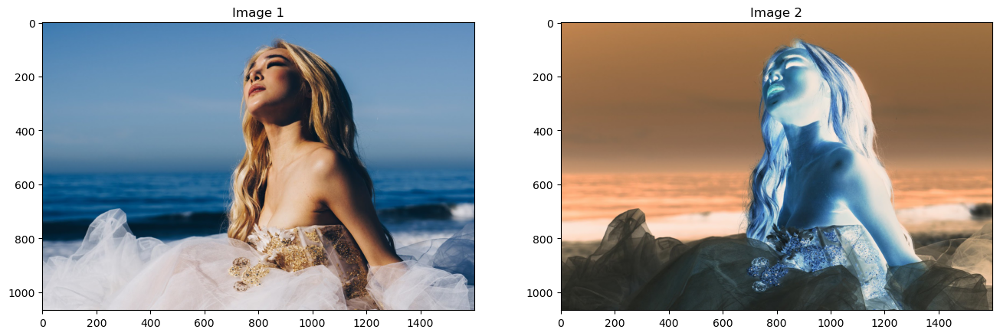

In [31]:
from skimage import util
inversion = util.invert(image_color)
ShowTwoImages(image_color, inversion)

#### Xuất ảnh enhance contrast


41.0 207.0


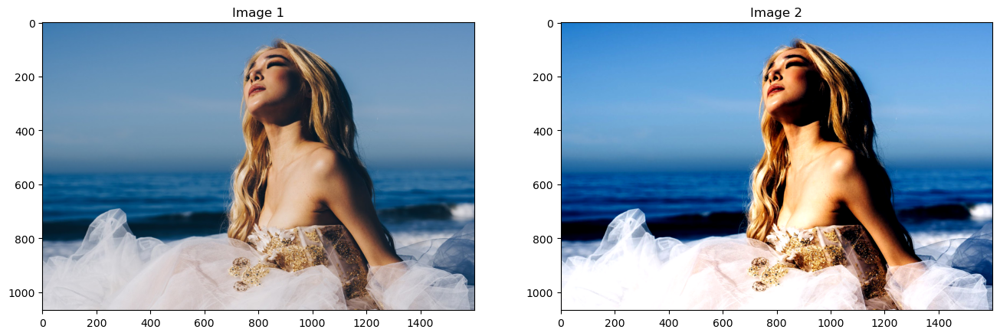

In [32]:
import numpy as np
from skimage import exposure

#lấy từ 10->90 phần trăm khoảng màu
v_min, v_max = np.percentile(image_color, (10, 90))
better_constrast = exposure.rescale_intensity(image_color, in_range = (v_min, v_max))

print(v_min, v_max)
ShowTwoImages(image_color, better_constrast)

#### Xuất ảnh gamma và log enhancement 


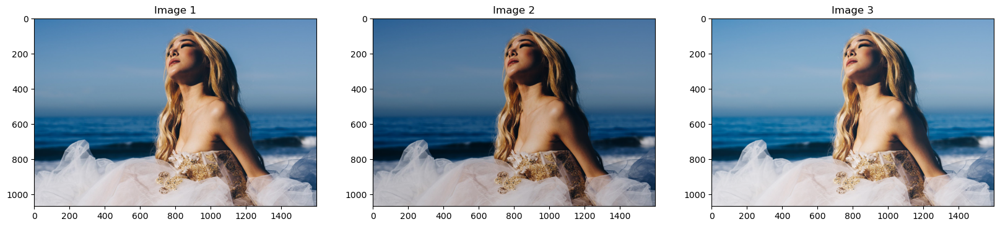

In [33]:
#gamma
adjusted_gamma = exposure.adjust_gamma(image_color, gamma=1.2, gain=0.9)

#log enhancement
log_correction = exposure.adjust_log(image_color)
ShowThreeImages(image_color, adjusted_gamma, log_correction)

### Bài tập làm thêm:

Image Size: (1200, 800, 3)


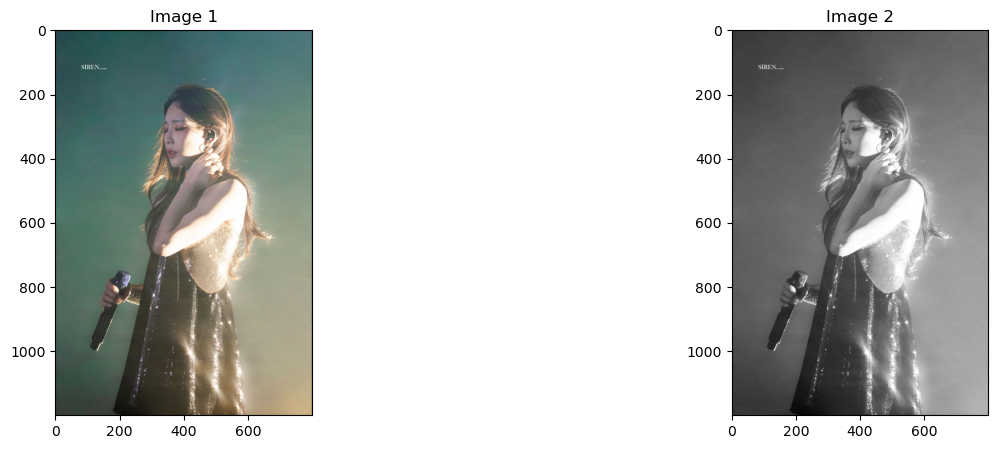

In [15]:
# Read Image 
image_color = imread("siren.jpg")
# Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image
print("Image Size:", image_color.shape)
ShowTwoImages(image_color, image_gray)

#### Tích chập hình ảnh:

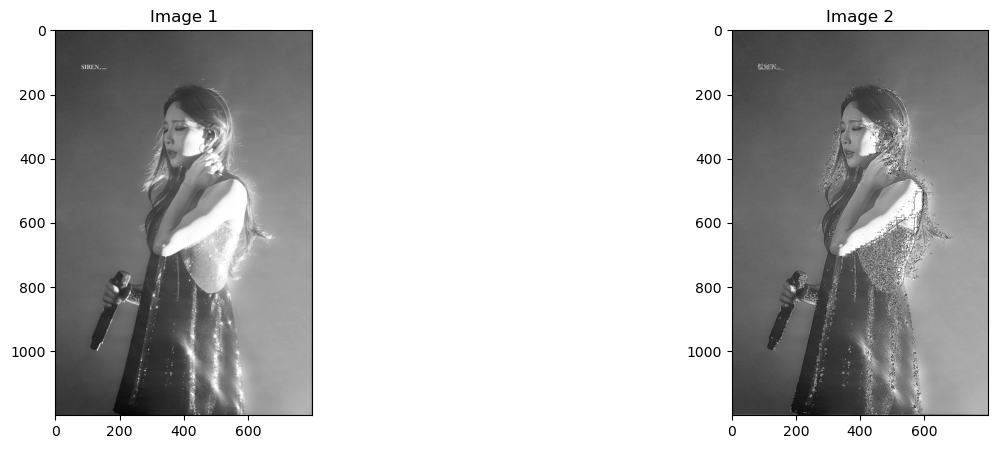

In [16]:
def convolve(image, kernel): 
    
    #Đảo ngược kernel để tính tích chập
    kernel = np.flipud(np.fliplr(kernel))
    #Convolution output (tích chập)
    output = np.zeros_like(image) #trả về mảng số 0 có kích thước như mảng của image
    
    #Tạo ma trận nền bằng 0, lớn hơn kích thước hình ảnh hiện tại 
    image_padded = np.zeros((image.shape[0] + 2, image.shape[1] + 2))
    #Gán ảnh đầu vào vào trung tâm của ma trận nền
    image_padded[1:-1, 1:-1] = image
    
    #Lặp trên mỗi pixel của image
    for x in range(image.shape[1]):
        for y in range(image.shape[0]):
            #Nhân từng phần tử của kernel với image rồi lấy tổng
            output[y, x]=(kernel * image_padded[y: y+3, x: x+3]).sum()

    return output

#Sử dụng kernel để làm sắc nét hình ảnh
KERNEL = np.array([[0, -1, 0], [-1, 5, -1], [0, -1, 0]])
image_sharpen = convolve(image_gray, kernel=KERNEL)
ShowTwoImages(image_gray, image_sharpen)

#### Sử dụng tích chập để phát hiện biên của hình ảnh

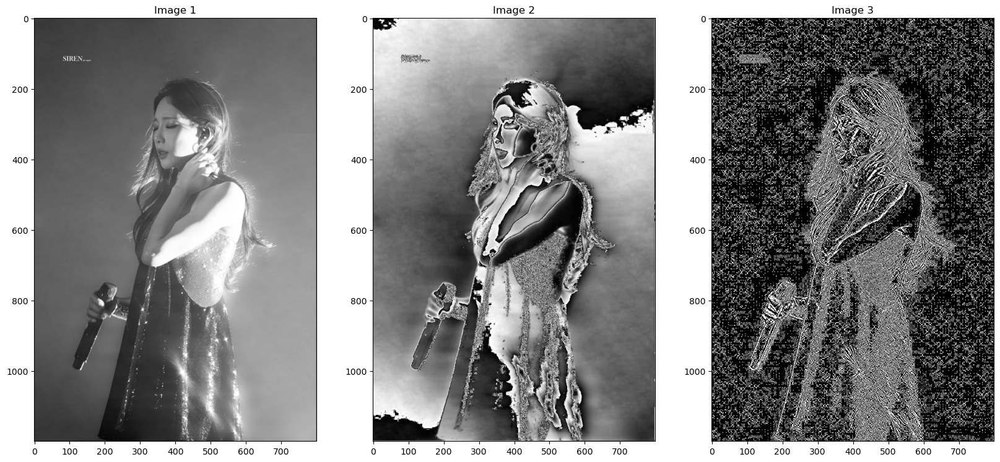

In [17]:
image_edge1 = convolve(image_gray, kernel=np.array([[-1, -1, -1], [-1, 4, -1],[-1, -1, -1]]))
image_edge2 = convolve(image_gray, kernel=np.array([[-1, 0, 1], [0, 0, 0], [1, 0, -1]]))
ShowThreeImages(image_gray, image_edge1, image_edge2)

#### Sử dụng tích chập để làm mờ hình ảnh

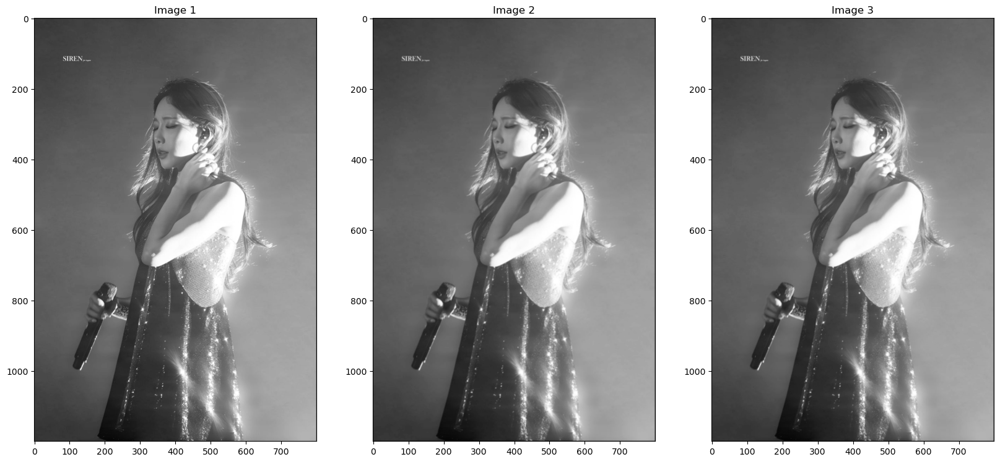

In [19]:
#Kernel dùng cho box blur
boxblur = convolve(image_gray, kernel=np.array([[1, 1, 1], [1, 1, 1], [1, 1, 1]])/9.0)
#chia 9 để chuẩn hóa kernel, đảm bảo tổng trọng số là 1 
#mỗi pixel được làm mờ bằng trung bình cộng của 9 pixel xung quanh nó


#Kernel dùng cho gaussian blug
gaussianblur = convolve(image_gray, kernel=np.array([[1, 2, 1], [2, 4, 2], [1, 2, 1]])/16.0)
#chia 16 để chuẩn hóa kernel, đảm bảo tổng trọng số là 1 
#và làm hiệu ứng mờ trở nên mịn hơn

ShowThreeImages(image_gray, boxblur, gaussianblur)